In [1]:

import imageio.v2 as imageio
import numpy as np
from scipy import misc
import matplotlib.pyplot as plt

C:\Users\denis\AppData\Local\Temp\ipykernel_52032\231301295.py:3: DeprecationWarning: scipy.misc is deprecated and will be removed in 2.0.0
  from scipy import misc


In [2]:
from skimage import data

photo_data = imageio.imread('sd-3layers.jpg')

type(photo_data)

numpy.ndarray

immagine

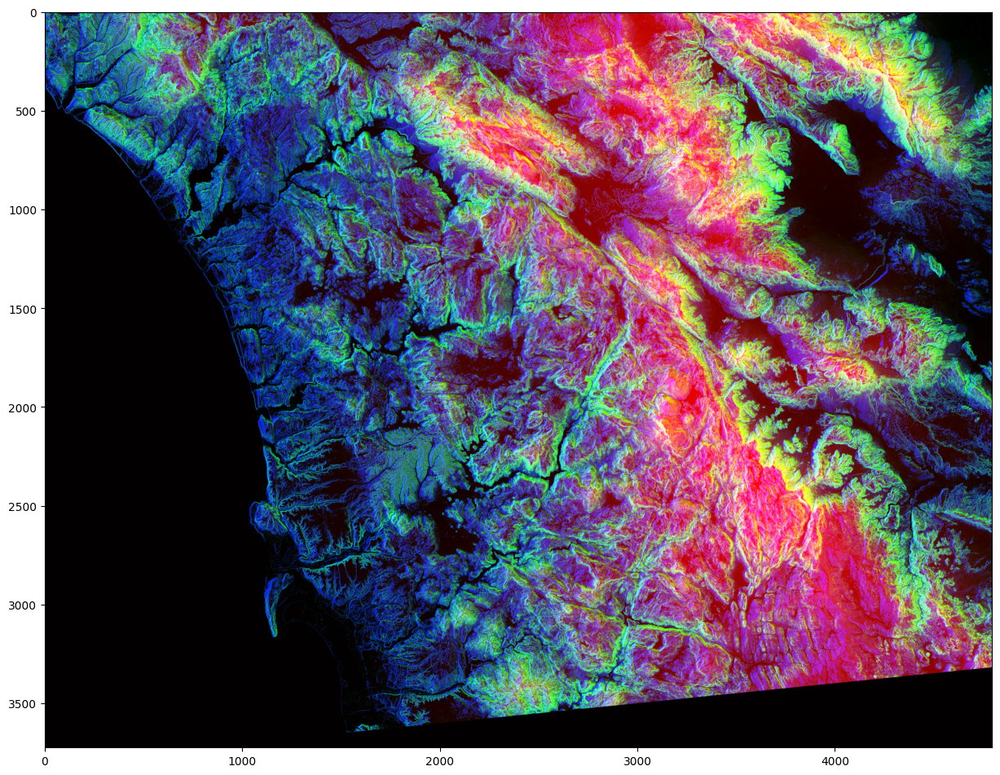

In [3]:
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

In [4]:
photo_data.shape

#print(photo_data)

(3725, 4797, 3)

La forma dell'ndarray mostra che è una matrice a tre strati. I primi due numeri  sono lunghezza e larghezza, e il terzo numero (cioè 3) è per tre strati: Rosso, Verde e Blu.

Il pixel ROSSO indica l'altitudine

Il pixel BLU indica l'aspetto

Il pixel VERDE indica la pendenza

In [5]:
photo_data.size

53606475

In [6]:
photo_data.min(), photo_data.max()

(0, 255)

In [7]:
photo_data.mean()

75.77772429543259

Pixel alla 150-esima rigaw e 250-esima colonna

In [8]:
photo_data[150, 250]

array([ 15,  42, 233], dtype=uint8)

In [9]:
photo_data[150, 250, 1]

42

Impostare un pixel su tutti gli zeri


Possiamo impostare tutti e tre i livelli di un pixel  assegnando lo zero  a quell'accoppiamento (riga, colonna). Tuttavia, l'impostazione di un pixel a zero non si nota.

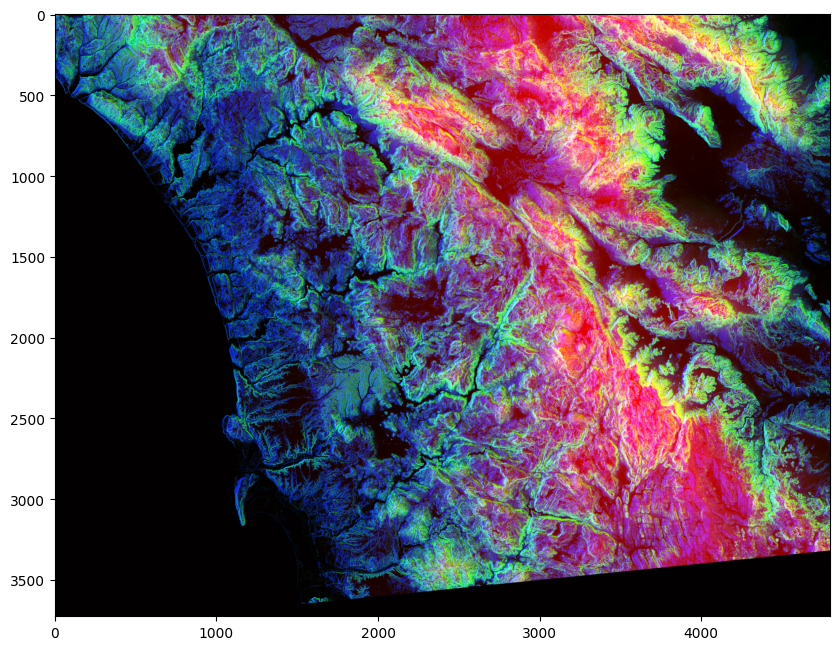

In [10]:
#photo_data = misc.imread('./wifire/sd-3layers.jpg')
photo_data[150, 250] = 0
plt.figure(figsize=(10,10))
plt.imshow(photo_data)

Cambiare i colori in un intervallo


Possiamo anche usare un intervallo per cambiare i valori dei pixel. Come esempio, impostiamo il livello del verde per le righe da 200 a 800 alla massima intensità.

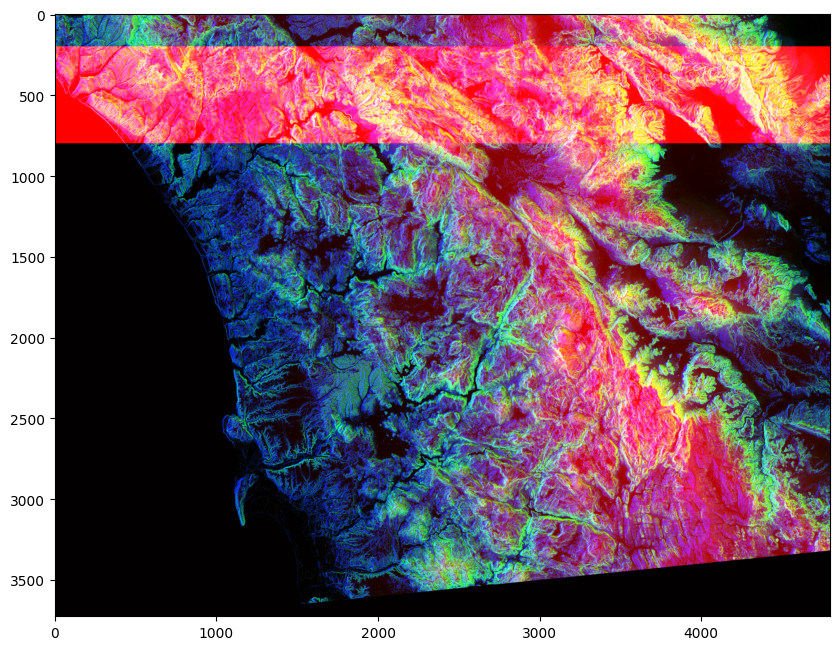

In [11]:

photo_data = imageio.imread('sd-3layers.jpg')

photo_data[200:800, : ,0] = 255
plt.figure(figsize=(10,10))
plt.imshow(photo_data)

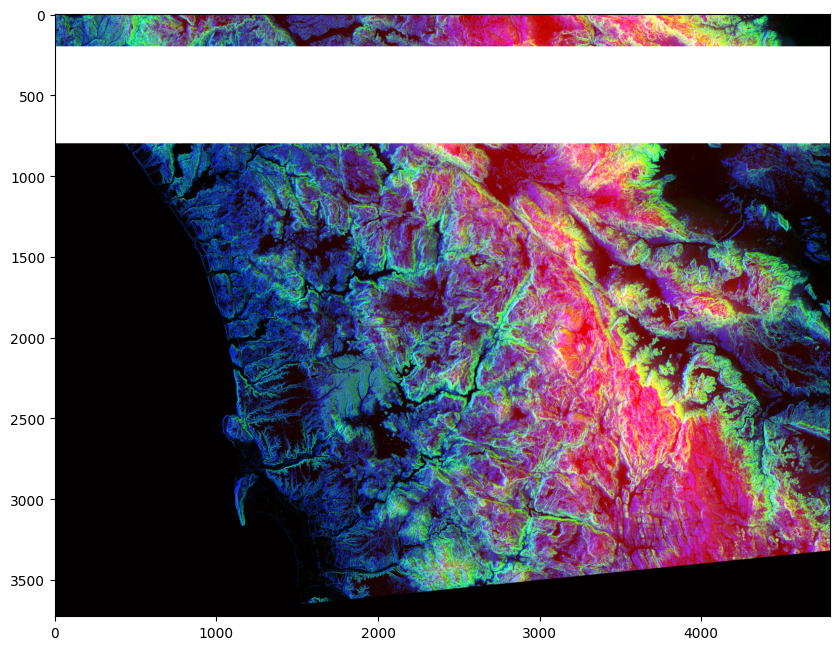

In [12]:
photo_data = imageio.imread('sd-3layers.jpg')

photo_data[200:800, :] = 255
plt.figure(figsize=(10,10))
plt.imshow(photo_data)

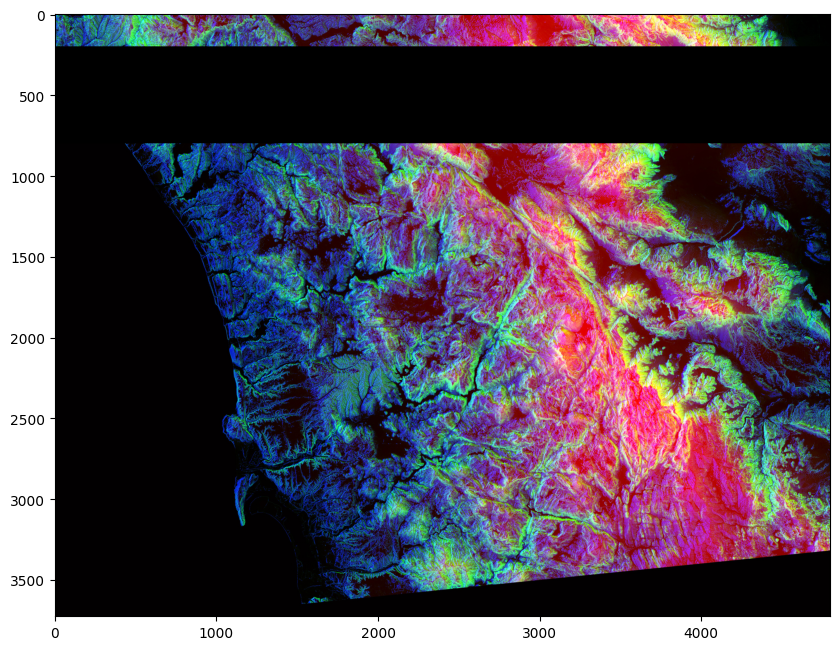

In [13]:
photo_data = imageio.imread('sd-3layers.jpg')

photo_data[200:800, :] = 0
plt.figure(figsize=(10,10))
plt.imshow(photo_data)

<h1 style="color:red">Seleziona tutti i pixel con valori bassi</h1>


In [14]:
photo_data = imageio.imread('sd-3layers.jpg')
print("Shape of photo_data:", photo_data.shape)
low_value_filter = photo_data < 200
print("Shape of low_value_filter:", low_value_filter.shape)


Shape of photo_data: (3725, 4797, 3)
Shape of low_value_filter: (3725, 4797, 3)


<h1>Filtrare i valori bassi

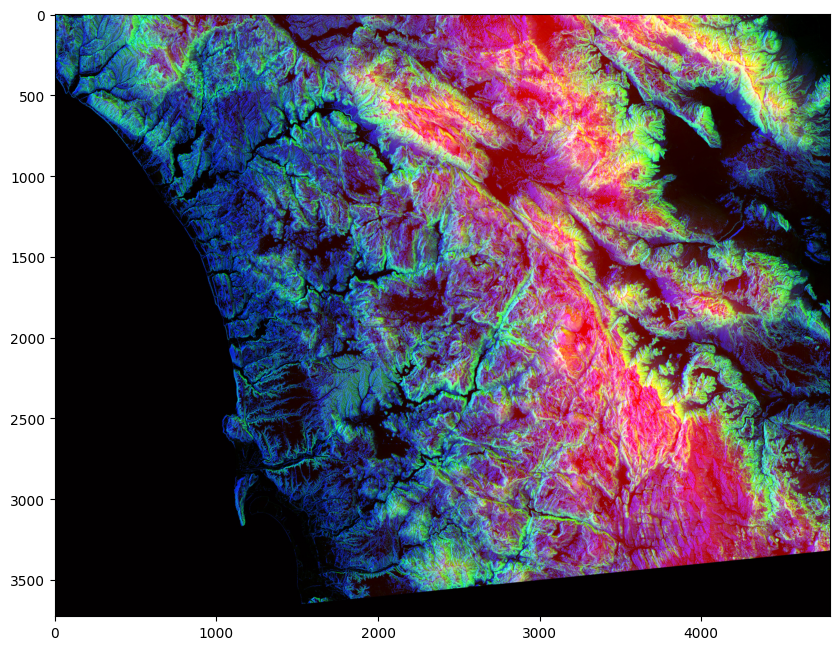

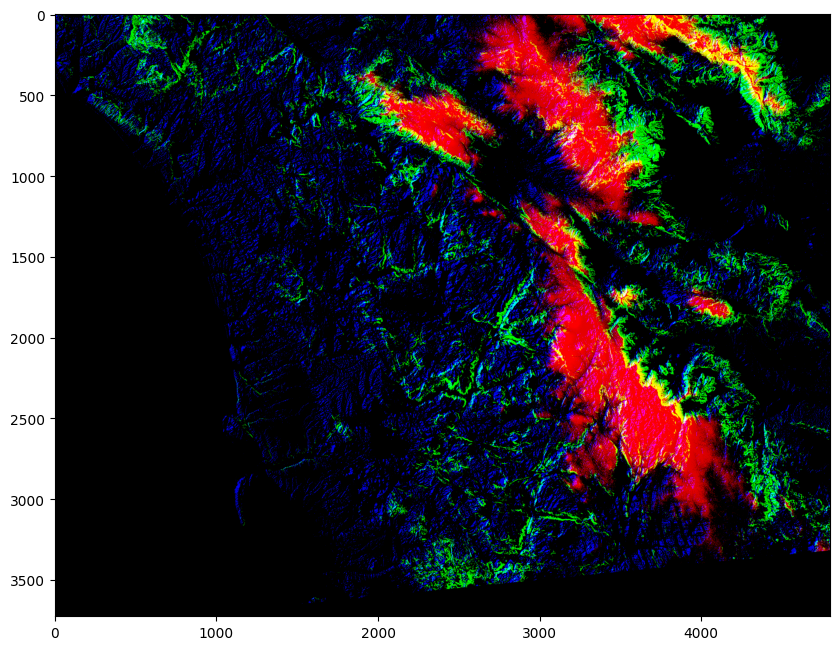

In [15]:
#import random
plt.figure(figsize=(10,10))
plt.imshow(photo_data)
photo_data[low_value_filter] = 0
plt.figure(figsize=(10,10))
plt.imshow(photo_data)

Altre operazioni su righe e colonne


Puoi progettare schemi complessi rendendo le colonne una funzione delle righe o viceversa. Qui proviamo una relazione lineare tra righe e colonne.

In [16]:
rows_range = np.arange(len(photo_data))
cols_range = rows_range
print(type(rows_range))

<class 'numpy.ndarray'>


In [17]:
photo_data[rows_range, cols_range] = 255

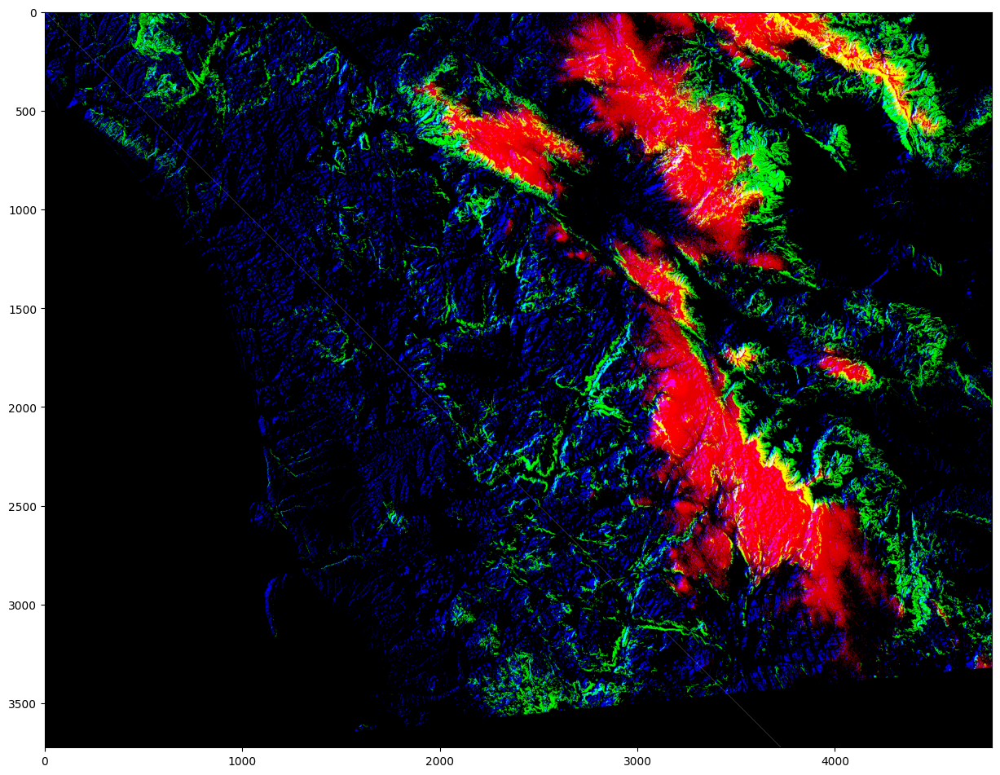

In [18]:
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

Mascheramento delle immagini


Ora proviamo qualcosa una maschera che ha la forma di un disco circolare.


In [19]:
total_rows, total_cols, total_layers = photo_data.shape
#print("photo_data = ", photo_data.shape)

X, Y = np.ogrid[:total_rows, :total_cols]
print("X = ", X.shape, " and Y = ", Y.shape)

X =  (3725, 1)  and Y =  (1, 4797)


In [20]:
center_row, center_col = total_rows / 2, total_cols / 2
#print("center_row = ", center_row, "AND center_col = ", center_col)
#print(X - center_row)
#print(Y - center_col)
dist_from_center = (X - center_row)**2 + (Y - center_col)**2
#print(dist_from_center)
radius = (total_rows / 2)**2
#print("Radius = ", radius)
circular_mask = (dist_from_center > radius)
#print(circular_mask)
print(circular_mask[1500:1700,2000:2200])

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]


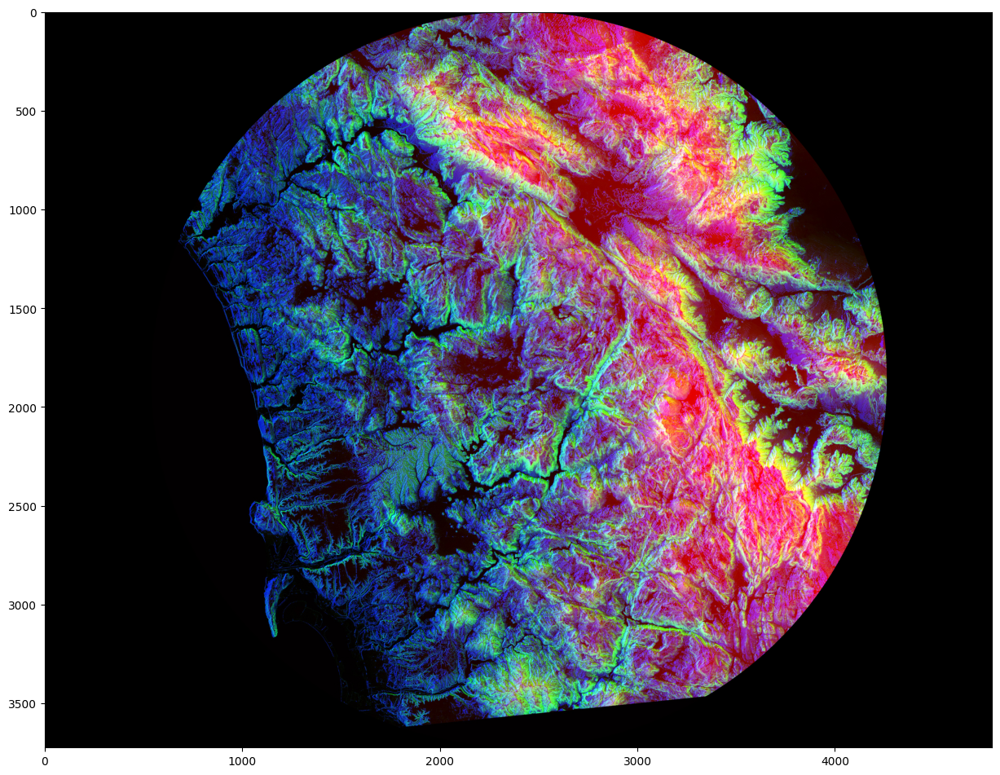

In [21]:
photo_data = imageio.imread('sd-3layers.jpg')
photo_data[circular_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

Ulteriore mascheratura


È possibile migliorare ulteriormente la maschera, per esempio ottenere solo la metà superiore del disco.

In [22]:
X, Y = np.ogrid[:total_rows, :total_cols]
half_upper = X < center_row # genera una maschera per tutte le righe sopra il centro

half_upper_mask = np.logical_and(half_upper, circular_mask)

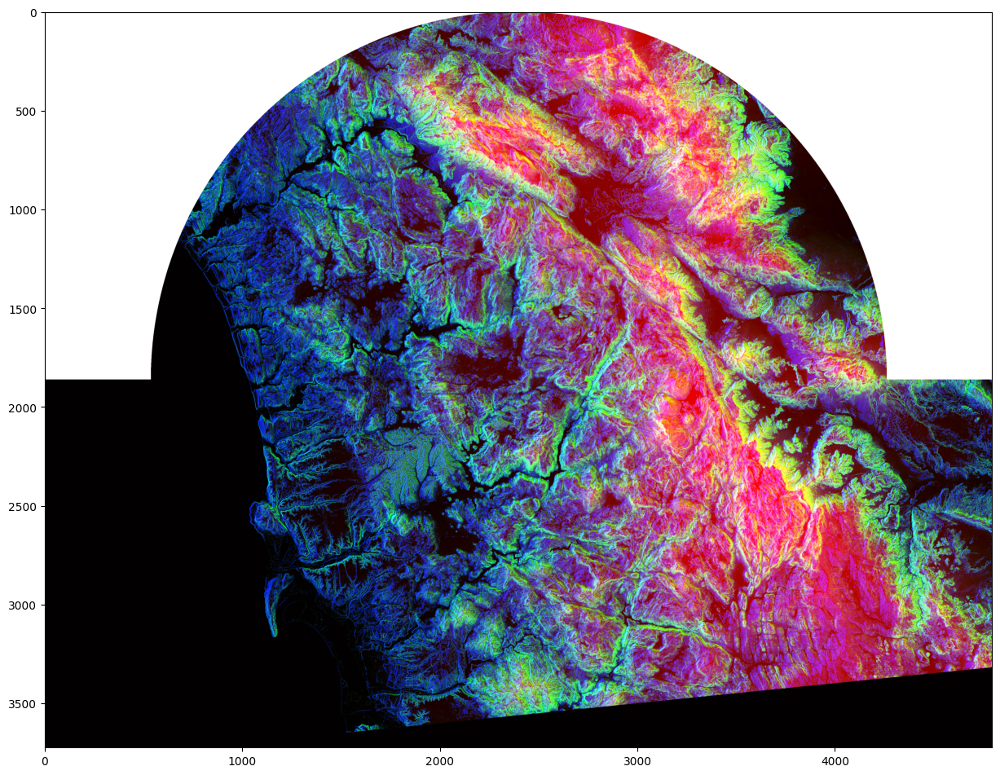

In [23]:
photo_data = imageio.imread('sd-3layers.jpg')
photo_data[half_upper_mask] = 255
#photo_data[half_upper_mask] = random.randint(200,255)
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

Ulteriore elaborazione delle nostre immagini satellitari

Elaborazione dei pixel rossi

Ricordate che i pixel rossi ci dicono l'altezza. Cerchiamo di evidenziare tutte le aree ad alta quota. Lo faremo rilevando i pixel rossi ad alta intensità e smorzando le altre aree.

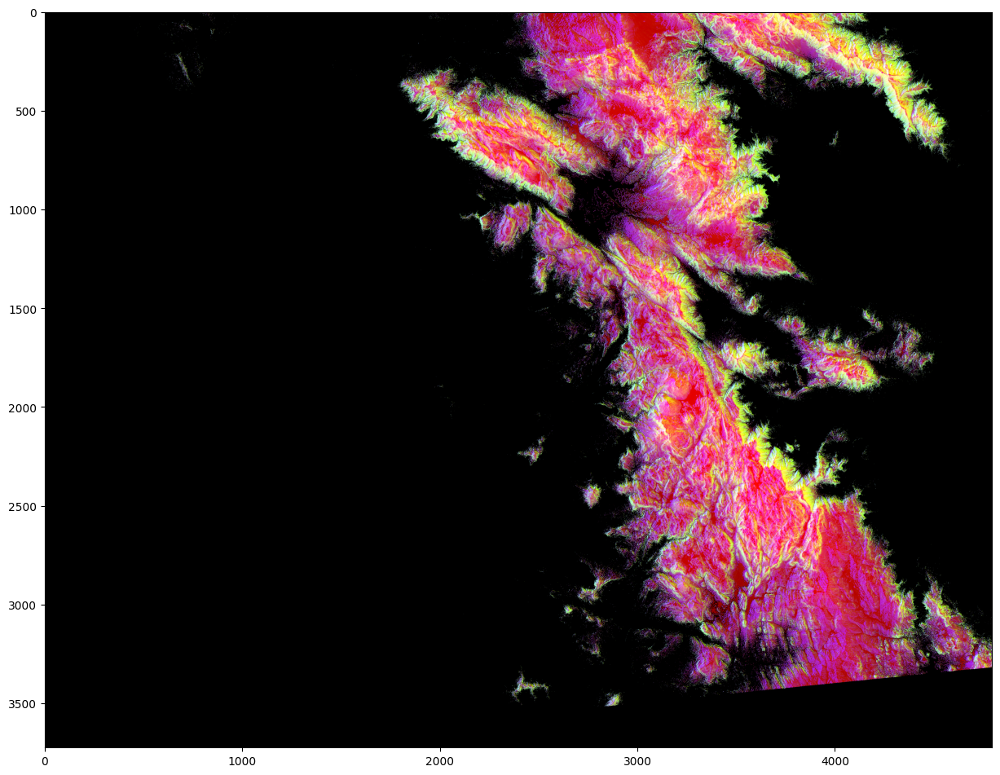

In [24]:
import imageio.v2 as imageio
import numpy as np
from scipy import misc
import matplotlib.pyplot as plt
photo_data3 = imageio.imread('sd-3layers.jpg')
red_mask   = photo_data3[:, : ,0] < 150

photo_data3[red_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data3)

Rilevamento dei pixel verdi

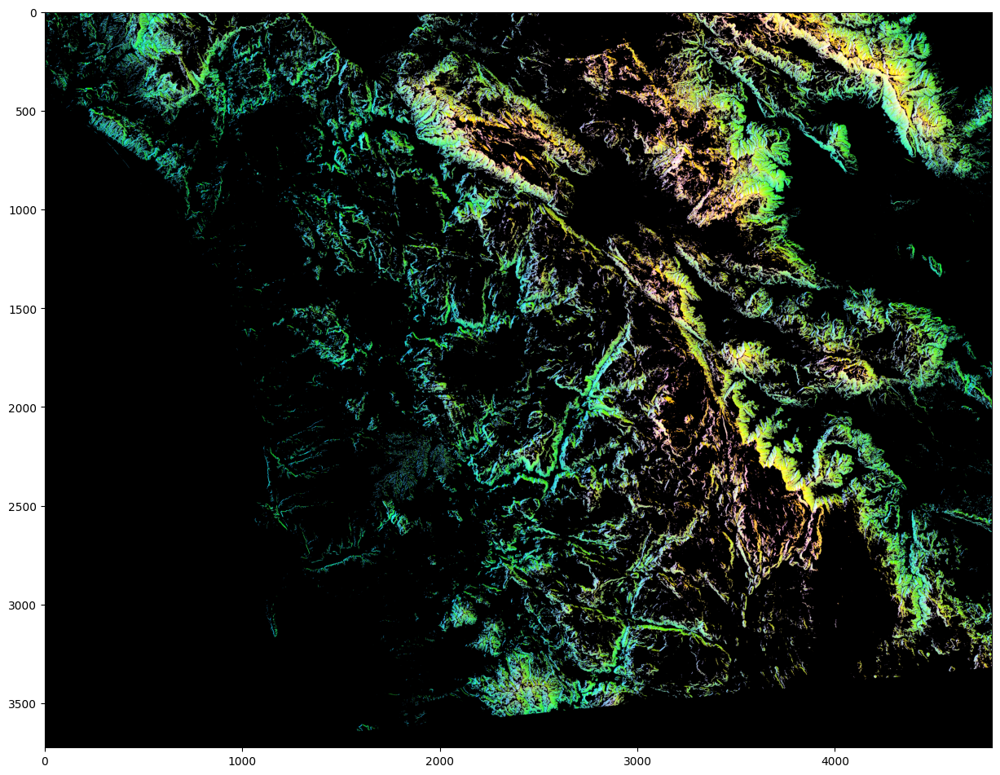

In [25]:
photo_data = imageio.imread('sd-3layers.jpg')
green_mask = photo_data[:, : ,1] < 150

photo_data[green_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

rilevamento pixel blue

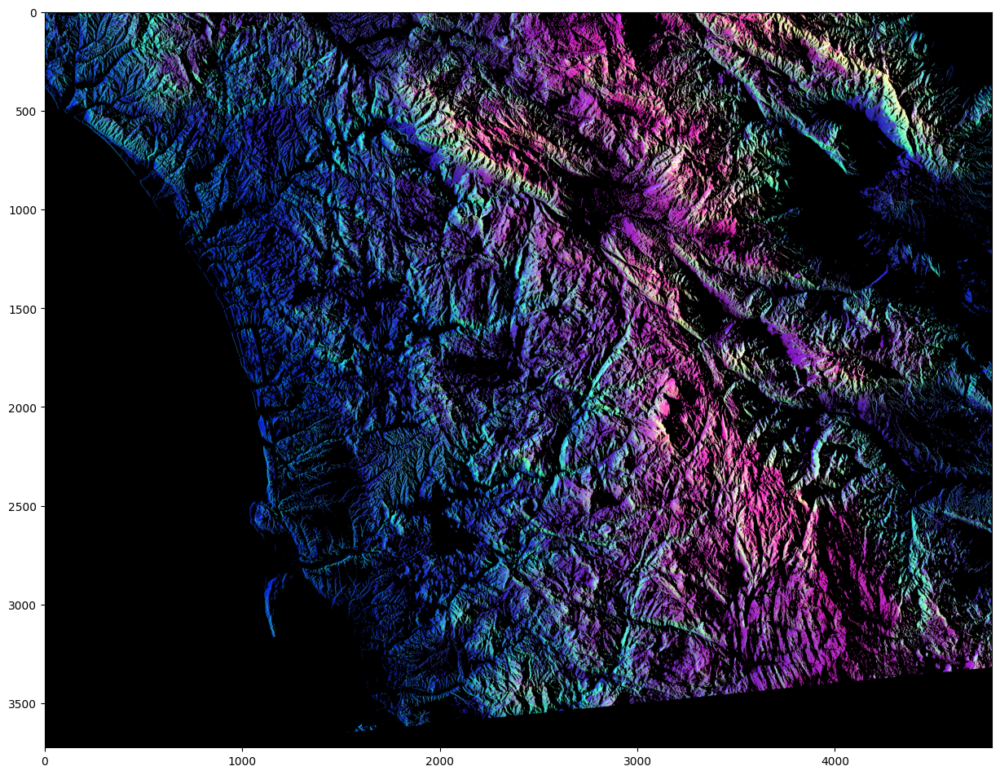

In [26]:
import imageio.v2 as imageio
import numpy as np
from scipy import misc
import matplotlib.pyplot as plt
photo_data = imageio.imread('sd-3layers.jpg')
blue_mask  = photo_data[:, : ,2] < 150

photo_data[blue_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

Maschera  che prende le soglie su tutti e tre i livelli: ROSSO, VERDE, BLU

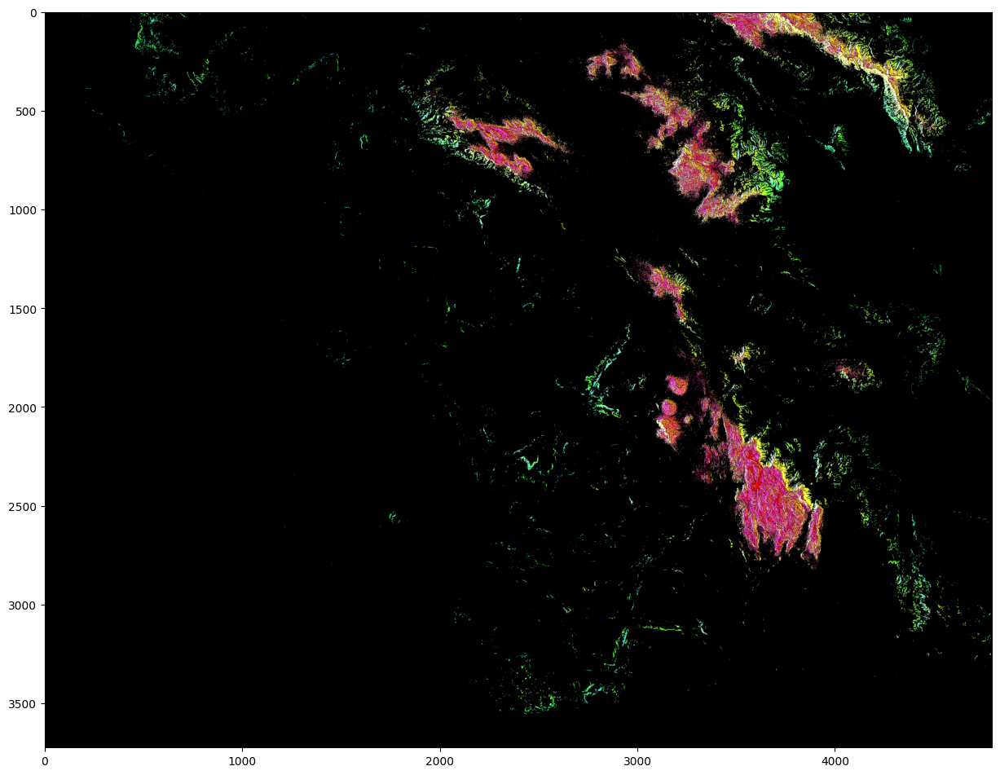

In [27]:
import imageio.v2 as imageio
import numpy as np
from scipy import misc
import matplotlib.pyplot as plt
photo_data = imageio.imread('sd-3layers.jpg')
red_mask   = photo_data[:, : ,0] <250
green_mask = photo_data[:, : ,1] < 250
blue_mask  = photo_data[:, : ,2]<1

final_mask = np.logical_and(red_mask, green_mask, blue_mask)
photo_data[final_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(photo_data)

In [28]:
import skimage.io
skimage.io.imsave(fname="clip.tif", arr=photo_data)